# Imports

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

from matplotlib import animation
from IPython import display

import torch
import torch.nn as nn
import torch.optim as optim
from torch import Tensor
from torch.utils.data import TensorDataset
from torch.utils.data import DataLoader
from torch.utils.data import DataLoader

from torchsummary import summary

from tqdm import tqdm

In [2]:
if not os.path.exists("checkpoints"):
    os.mkdir("checkpoints")

# Preprocessing Utilities

In [3]:
data_dir: str = '/media/jychpr/ADATA SD810/kaggle_data/google-research-identify-contrails-reduce-global-warming'

In [4]:
df_train_idx = pd.DataFrame({'idx': os.listdir(os.path.join(data_dir, 'train'))})
df_validation_idx = pd.DataFrame({'idx': os.listdir(os.path.join(data_dir, 'validation'))})
df_test_idx = pd.DataFrame({'idx': os.listdir(os.path.join(data_dir, 'test'))})

In [5]:
def get_band_images(idx: str, parrent_folder: str, band: str) -> np.array:
    return np.load(os.path.join(data_dir, parrent_folder, idx, f'band_{band}.npy'))

In [6]:
_T11_BOUNDS = (243, 303)
_CLOUD_TOP_TDIFF_BOUNDS = (-4, 5)
_TDIFF_BOUNDS = (-4, 2)

def normalize_range(data, bounds):
    """Maps data to the range [0, 1]."""
    return (data - bounds[0]) / (bounds[1] - bounds[0])


def get_ash_color_images(idx: str, parrent_folder: str, get_mask_frame_only=False) -> np.array:
    band11 = get_band_images(idx, parrent_folder, '11')
    band14 = get_band_images(idx, parrent_folder, '14')
    band15 = get_band_images(idx, parrent_folder, '15')
    
    if get_mask_frame_only:
        band11 = band11[:,:,4]
        band14 = band14[:,:,4]
        band15 = band15[:,:,4]

    r = normalize_range(band15 - band14, _TDIFF_BOUNDS)
    g = normalize_range(band14 - band11, _CLOUD_TOP_TDIFF_BOUNDS)
    b = normalize_range(band14, _T11_BOUNDS)
    false_color = np.clip(np.stack([r, g, b], axis=2), 0, 1)
    return false_color

In [7]:
def get_mask_image(idx: str, parrent_folder: str) -> np.array:
    return np.load(os.path.join(data_dir, parrent_folder, idx, 'human_pixel_masks.npy')) 

# EDA

In [8]:
train_images_with_contrails = 0
train_images_without_contrails = 0
train_contrail_pixel_count = 0
train_non_contrail_pixel_count = 0
train_contrail_pixel_count_conly = 0
train_non_contrail_pixel_count_conly = 0
img_pixel_count = 256 * 256

for idx in df_train_idx['idx']:
    mask = get_mask_image(idx, 'train')
    contrail_pixel_count = np.sum(mask > 0)
    
    if contrail_pixel_count > 0:
        train_images_with_contrails += 1
        train_contrail_pixel_count_conly += contrail_pixel_count
        train_non_contrail_pixel_count_conly += (img_pixel_count - contrail_pixel_count)
    else:
        train_images_without_contrails += 1
        
    train_contrail_pixel_count += contrail_pixel_count
    train_non_contrail_pixel_count += (img_pixel_count - contrail_pixel_count)

In [9]:
validation_images_with_contrails = 0
validation_images_without_contrails = 0
validation_contrail_pixel_count = 0
validation_non_contrail_pixel_count = 0
validation_contrail_pixel_count_conly = 0
validation_non_contrail_pixel_count_conly = 0
img_pixel_count = 256 * 256

for idx in df_validation_idx['idx']:
    mask = get_mask_image(idx, 'validation')
    contrail_pixel_count = np.sum(mask > 0)
    
    if contrail_pixel_count > 0:
        validation_images_with_contrails += 1
        validation_contrail_pixel_count_conly += contrail_pixel_count
        validation_non_contrail_pixel_count_conly += (img_pixel_count - contrail_pixel_count)
    else:
        validation_images_without_contrails += 1
        
    validation_contrail_pixel_count += contrail_pixel_count
    validation_non_contrail_pixel_count += (img_pixel_count - contrail_pixel_count)

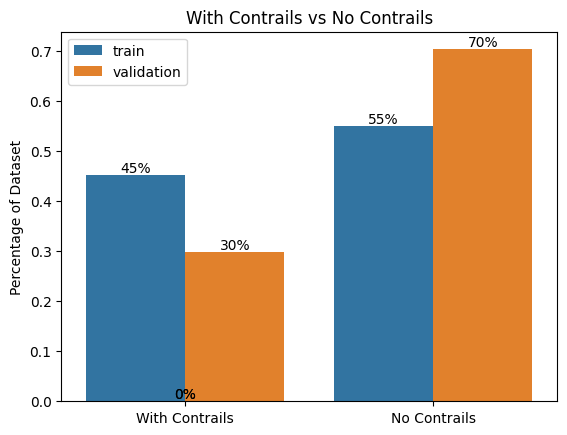

In [10]:
train_with_contrails = train_images_with_contrails / (train_images_with_contrails + train_images_without_contrails)
train_without_contrails = train_images_without_contrails / (train_images_with_contrails + train_images_without_contrails)
validation_with_contrails = validation_images_with_contrails / (validation_images_with_contrails + validation_images_without_contrails)
validation_without_contrails = validation_images_without_contrails / (validation_images_with_contrails + validation_images_without_contrails)
data = pd.DataFrame({'Type': ['With Contrails', 'No Contrails', 'With Contrails', 'No Contrails'],
        'Data': [train_with_contrails, train_without_contrails, validation_with_contrails, validation_without_contrails],
        'Data Set': ['train', 'train', 'validation', 'validation']})

ax = sns.barplot(data=data, y='Data', x="Type", hue="Data Set", orient='v')

for p in ax.patches:
    ax.annotate(format(p.get_height() * 100, '.0f') + '%',
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
    
ax.set_xlabel('')
ax.set_ylabel('Percentage of Dataset')
ax.set_title('With Contrails vs No Contrails')

plt.legend()
plt.show()

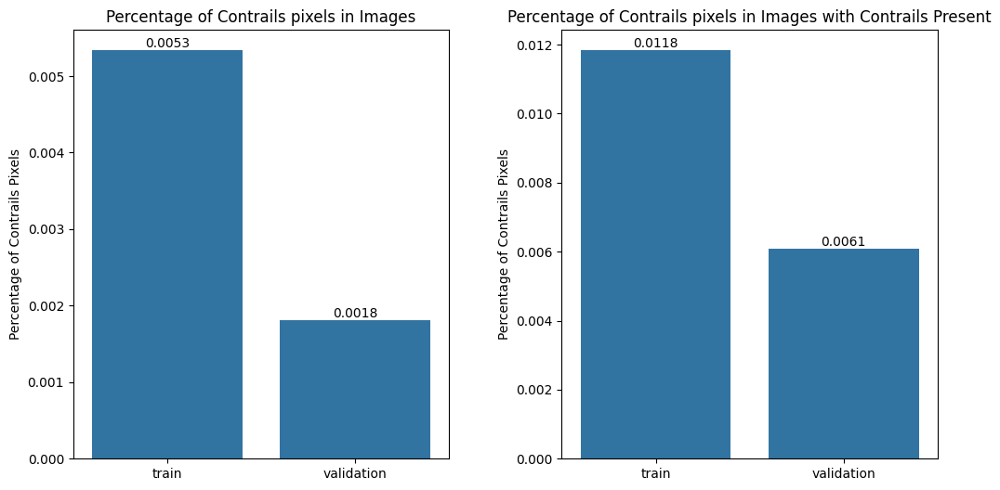

In [11]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))
fig.subplots_adjust(wspace=0.3)
axes = axes.flatten()

train_with_contrails_pix = train_contrail_pixel_count / (train_contrail_pixel_count + train_non_contrail_pixel_count)
validation_with_contrails_pix = validation_contrail_pixel_count / (validation_contrail_pixel_count + validation_non_contrail_pixel_count)
data = pd.DataFrame({'Data': [train_with_contrails_pix, validation_with_contrails_pix],
        'Data Set': ['train', 'validation']})
sns.barplot(data=data, y='Data', x="Data Set", orient='v', ax=axes[0])
for p in axes[0].patches:
    axes[0].annotate(format(p.get_height(), '.4f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
axes[0].set_xlabel('')
axes[0].set_ylabel('Percentage of Contrails Pixels')
axes[0].set_title('Percentage of Contrails pixels in Images')

train_with_contrails_pix_conly = train_contrail_pixel_count_conly / (train_contrail_pixel_count_conly + train_non_contrail_pixel_count_conly)
validation_with_contrails_pix_conly = validation_contrail_pixel_count_conly / (validation_contrail_pixel_count_conly + validation_non_contrail_pixel_count_conly)
data = pd.DataFrame({'Data': [train_with_contrails_pix_conly, validation_with_contrails_pix_conly],
        'Data Set': ['train', 'validation']})
sns.barplot(data=data, y='Data', x="Data Set", orient='v', ax=axes[1])
for p in axes[1].patches:
    axes[1].annotate(format(p.get_height(), '.4f'),
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha = 'center', va = 'center',
                xytext = (0, 5),
                textcoords = 'offset points')
axes[1].set_xlabel('')
axes[1].set_ylabel('Percentage of Contrails Pixels')
axes[1].set_title('Percentage of Contrails pixels in Images with Contrails Present')

plt.show()

In [12]:
def show_band_images(idx: str, parrent_folder: str, band: str):
    data = get_band_images(idx, parrent_folder, band)
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))
    axes = axes.flatten()
    for i in range(8):
        axes[i].imshow(data[:,:,i])
        axes[i].axis('off')
    plt.show()

def show_ash_images(idx: str, parrent_folder: str):
    data = get_ash_color_images(idx, parrent_folder)
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))
    axes = axes.flatten()
    for i in range(8):
        axes[i].imshow(data[:,:,:,i])
        axes[i].axis('off')
    plt.show()

def show_ash_frame(idx: str, parrent_folder: str, frame: int):
    data = get_ash_color_images(idx, parrent_folder)
    plt.imshow(data[:,:,:,frame])
    plt.show()
    
def show_mask_image(idx: str, parrent_folder: str):
    plt.imshow(get_mask_image(idx, parrent_folder))
    plt.show()

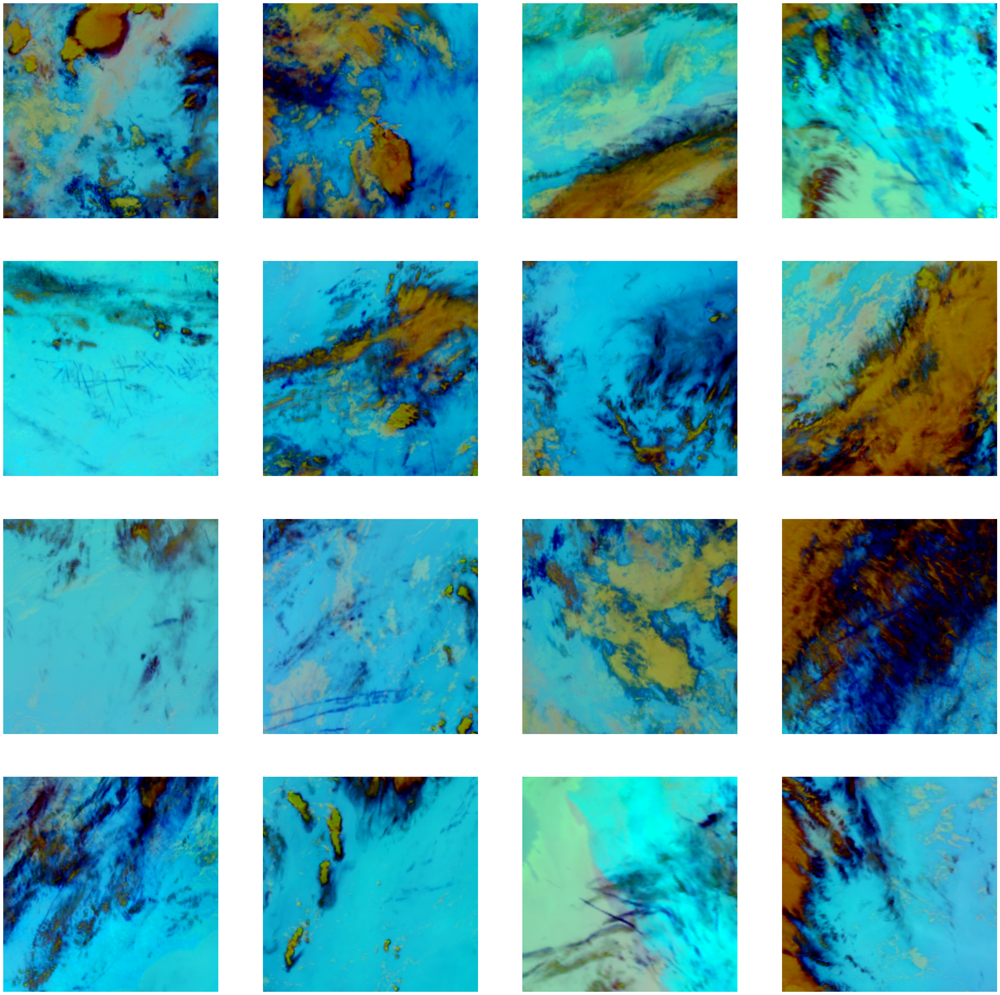

In [13]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(40, 40))
axes = axes.flatten()

for i in range(len(axes)):
    images = get_ash_color_images(str(df_train_idx.iloc[730 + i]['idx']), 'train')
    axes[i].imshow(images[:,:,:,4])
    axes[i].axis('off')

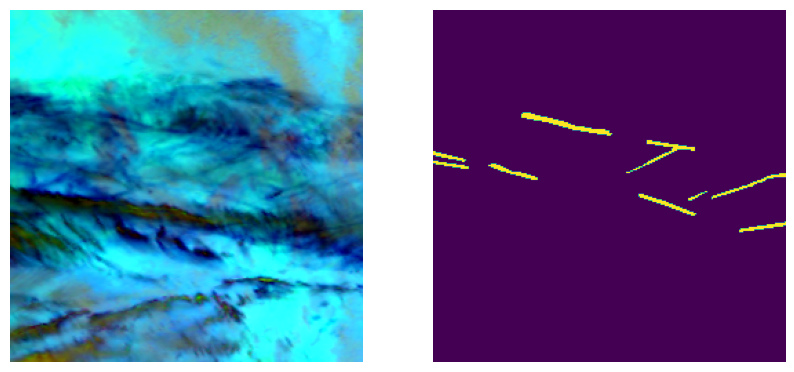

In [14]:
images = get_ash_color_images(str(df_train_idx.iloc[683]['idx']), 'train')
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
axes = axes.flatten()

axes[0].imshow(images[:,:,:,4])
axes[0].axis('off')
axes[1].imshow(get_mask_image(str(df_train_idx.iloc[683]['idx']), 'train'))
axes[1].axis('off')

plt.show()

# Model

In [15]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [16]:
class EfficientNetB7Encoder(nn.Module):
    def __init__(self, pretrained=True):
        super(EfficientNetB7Encoder, self).__init__()
        from torchvision.models import efficientnet_b7, EfficientNet_B7_Weights

        weights = EfficientNet_B7_Weights.IMAGENET1K_V1 if pretrained else None
        self.efficientnet = efficientnet_b7(weights=weights)

        # Adapt input channels to 3 (expected by EfficientNet)
        self.input_conv = nn.Conv2d(24, 3, kernel_size=1, stride=1, padding=0)

        # Extract encoder stages
        self.stages = nn.ModuleList([
            nn.Sequential(self.efficientnet.features[0]),
            nn.Sequential(*self.efficientnet.features[1:3]),
            nn.Sequential(*self.efficientnet.features[3:5]),
            nn.Sequential(*self.efficientnet.features[5:8]),
            nn.Sequential(*self.efficientnet.features[8:]),
        ])

        self.out_channels = [64, 48, 160, 640, 2560]

    def forward(self, x):
        x = self.input_conv(x)  # Adjust input channels
        features = []
        for i, stage in enumerate(self.stages):
            x = stage(x)
            # print(f"Output of stage {i}: {x.shape}")  # Debugging shapes
            features.append(x)
        return features




class Up(nn.Module):
    def __init__(self, in_channels, out_channels, bilinear=True):
        super(Up, self).__init__()
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
        else:
            self.up = nn.ConvTranspose2d(in_channels, in_channels // 2, kernel_size=2, stride=2)

        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x1, x2):
        # Ensure x1 and x2 are tensors
        x1 = self.up(x1)
        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]
        x1 = nn.functional.pad(x1, [diffX // 2, diffX - diffX // 2, diffY // 2, diffY - diffY // 2])

        # Concatenate and pass through the conv layers
        x = torch.cat([x2, x1], dim=1)
        x = self.conv(x)
        return x


class EfficientNetUNet(nn.Module):
    def __init__(self, num_classes=1, encoder_type="B7", pretrained=True):
        super(EfficientNetUNet, self).__init__()
        if encoder_type == "B7":
            self.encoder = EfficientNetB7Encoder(pretrained=pretrained)
        else:
            raise ValueError("Unsupported encoder type.")

        encoder_out_channels = self.encoder.out_channels

        # Decoder
        self.up1 = Up(encoder_out_channels[-1] + encoder_out_channels[-2], 256)
        self.up2 = Up(256 + encoder_out_channels[-3], 128)
        self.up3 = Up(128 + encoder_out_channels[-4], 64)
        self.up4 = Up(64 + encoder_out_channels[-5], 32)

        # Final conv
        self.final_conv = nn.Conv2d(32, num_classes, kernel_size=1)

        # Final upsampling to match the target size
        self.final_upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)

    def forward(self, x):
        # Encoder
        enc_features = self.encoder(x)
        x5 = enc_features[-1]
        x4 = enc_features[-2]
        x3 = enc_features[-3]
        x2 = enc_features[-4]
        x1 = enc_features[-5]

        # Decoder
        x = self.up1(x5, x4)
        # print(f"Shape after up1: {x.shape}")  # Debugging

        x = self.up2(x, x3)
        # print(f"Shape after up2: {x.shape}")  # Debugging

        x = self.up3(x, x2)
        # print(f"Shape after up3: {x.shape}")  # Debugging

        x = self.up4(x, x1)
        # print(f"Shape after up4: {x.shape}")  # Debugging

        x = self.final_conv(x)
        # print(f"Shape after final_conv: {x.shape}")  # Debugging

        x = self.final_upsample(x)
        # print(f"Final output shape: {x.shape}")  # Debugging

        return x


In [17]:
summary(EfficientNetUNet().to(device), input_size=(24, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 3, 256, 256]              75
            Conv2d-2         [-1, 64, 128, 128]           1,728
            Conv2d-3         [-1, 64, 128, 128]           1,728
       BatchNorm2d-4         [-1, 64, 128, 128]             128
       BatchNorm2d-5         [-1, 64, 128, 128]             128
              SiLU-6         [-1, 64, 128, 128]               0
              SiLU-7         [-1, 64, 128, 128]               0
            Conv2d-8         [-1, 64, 128, 128]             576
            Conv2d-9         [-1, 64, 128, 128]             576
      BatchNorm2d-10         [-1, 64, 128, 128]             128
      BatchNorm2d-11         [-1, 64, 128, 128]             128
             SiLU-12         [-1, 64, 128, 128]               0
             SiLU-13         [-1, 64, 128, 128]               0
AdaptiveAvgPool2d-14             [-1, 6

# Trainer

In [18]:
class Dice(nn.Module):
    def __init__(self, use_sigmoid=True):
        super(Dice, self).__init__()
        self.sigmoid = nn.Sigmoid()
        self.use_sigmoid = use_sigmoid

    def forward(self, inputs, targets, smooth=1):
        if self.use_sigmoid:
            inputs = self.sigmoid(inputs)       
        
        inputs = inputs.view(-1)
        targets = targets.view(-1)
        
        intersection = (inputs * targets).sum()
        dice = (2.0 *intersection + smooth)/(inputs.sum() + targets.sum() + smooth)  
        
        return dice
    
dice = Dice()

In [19]:
class MyTrainer:
    def __init__(self, model, optimizer, loss_fn, lr_scheduler):
        self.validation_losses = []
        self.batch_losses = []
        self.epoch_losses = []
        self.learning_rates = []
        self.model = model
        self.optimizer = optimizer
        self.loss_fn = loss_fn
        self.lr_scheduler = lr_scheduler
        self._check_optim_net_aligned()

    # Ensures that the given optimizer points to the given model
    def _check_optim_net_aligned(self):
        assert self.optimizer.param_groups[0]['params'] == list(self.model.parameters())

    # Trains the model
    def fit(self,
            train_dataloader: DataLoader,
            test_dataloader: DataLoader,
            epochs: int = 10,
            eval_every: int = 1,
            ):
  
        for e in range(epochs):
            print("New learning rate: {}".format(self.lr_scheduler.get_last_lr()))
            self.learning_rates.append(self.lr_scheduler.get_last_lr()[0])

            # Stores data about the batch
            batch_losses = []
            sub_batch_losses = []

            for i, data in enumerate(tqdm(train_dataloader, desc=f"Epoch {e + 1}/{epochs} Training")):
                self.model.train()
                if i % 100 == 0:
                    print(f'epotch: {e} batch: {i}/{len(train_dataloader)} loss: {torch.Tensor(sub_batch_losses).mean()}')
                    sub_batch_losses.clear()
                # Every data instance is an input + label pair
                images, mask = data
                
                if torch.cuda.is_available():
                    images = images.cuda()
                    mask = mask.cuda()

                # Zero your gradients for every batch!
                self.optimizer.zero_grad()
                # Make predictions for this batch
                outputs = self.model(images)
                # Compute the loss and its gradients
                loss = self.loss_fn(outputs, mask)
                loss.backward()
                # Adjust learning weights
                self.optimizer.step()

                # Saves data
                self.batch_losses.append(loss.item())
                batch_losses.append(loss)
                sub_batch_losses.append(loss)

            # Adjusts learning rate
            if self.lr_scheduler is not None:
                self.lr_scheduler.step()

            # Reports on the path
            mean_epoch_loss = torch.Tensor(batch_losses).mean()
            self.epoch_losses.append(mean_epoch_loss.item())
            print('Train Epoch: {} Average Loss: {:.6f}'.format(e, mean_epoch_loss))

            # Reports on the training progress
            if (e + 1) % eval_every == 0:
                torch.save(self.model.state_dict(), "checkpoints/" + type(self.model).__name__ + "_model_checkpoint_e" + str(e) + ".pt")
                with torch.no_grad():
                    self.model.eval()
                    losses = []
                    for i, data in enumerate(tqdm(test_dataloader, desc=f"Epoch {e + 1}/{epochs} Validation")):
                        # Every data instance is an input + label pair
                        images, mask = data

                        if torch.cuda.is_available():
                            images = images.cuda()
                            mask = mask.cuda()

                        output = self.model(images)
                        loss = self.loss_fn(output, mask)
                        losses.append(loss.item())
                        
                    avg_loss = torch.Tensor(losses).mean().item()
                    self.validation_losses.append(avg_loss)
                    print("Validation loss after", (e + 1), "epochs was", round(avg_loss, 4))

# Dataset

In [20]:
class ContrailsAshDataset(torch.utils.data.Dataset):
    def __init__(self, parrent_folder: str):
        self.df_idx: pd.DataFrame = pd.DataFrame({'idx': os.listdir(f'/media/jychpr/ADATA SD810/kaggle_data/google-research-identify-contrails-reduce-global-warming/{parrent_folder}')})
        self.parrent_folder: str = parrent_folder

    def __len__(self):
        return len(self.df_idx)

    def __getitem__(self, idx):
        image_id: str = str(self.df_idx.iloc[idx]['idx'])
        images = torch.tensor(np.reshape(get_ash_color_images(image_id, self.parrent_folder, get_mask_frame_only=False), (256, 256, 24))).to(torch.float32).permute(2, 0, 1)
        mask = torch.tensor(get_mask_image(image_id, self.parrent_folder)).to(torch.float32).permute(2, 0, 1)
        return images, mask

In [21]:
dataset_train = ContrailsAshDataset('train')
dataset_validation = ContrailsAshDataset('validation')

data_loader_train = DataLoader(dataset_train, batch_size=16, shuffle=True, num_workers=2)
data_loader_validation = DataLoader(dataset_validation, batch_size=16, shuffle=True, num_workers=2)

# Train

In [22]:
train = False

In [23]:
if train:
    model = EfficientNetUNet()
    model.to(device)

    criterion = nn.BCEWithLogitsLoss(pos_weight=torch.tensor(100))
    optimizer = optim.Adam(model.parameters(), lr=0.01)
    lr_scheduler = torch.optim.lr_scheduler.ExponentialLR(optimizer, 0.70)

    num_epochs = 11

    trainer = MyTrainer(model, optimizer, criterion, lr_scheduler)
    trainer.fit(data_loader_train, data_loader_validation, epochs=num_epochs)
else:
    model = EfficientNetUNet()
    model.load_state_dict(torch.load('/home/jychpr/JC/ip-fp/Contrails-Segmentation/notebook_trials/checkpoints/EfficientNetUNet_model_checkpoint_e10.pt'))
    model.eval()
    model.to(device)

/tmp/ipykernel_142096/993082583.py:15: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load('/home/jychpr/JC/ip-fp/Contrails-Segmentation/notebook_

# Training Overview

In [24]:
if train:
    df_data = pd.DataFrame({'Batch Losses': trainer.batch_losses})

    sns.lineplot(data=df_data)
    plt.xlabel('Batch')
    plt.ylabel('Loss')
    plt.title('Batch Loss')
    plt.show()

In [25]:
if train:
    df_data = pd.DataFrame({'Loss': trainer.epoch_losses})

    sns.lineplot(data=df_data)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Model Average Training Loss over Epochs')
    plt.show()

In [26]:
if train:
    df_data = pd.DataFrame({'Loss': trainer.validation_losses})

    sns.lineplot(data=df_data)
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Model Validation Loss over Epochs')
    plt.show()

In [27]:
if train:
    df_data = pd.DataFrame({'Learning rates': trainer.learning_rates})

    sns.lineplot(data=df_data)
    plt.xlabel('Epoch')
    plt.ylabel('Learinig Rate')
    plt.title('Learinig Rate over Epochs')
    plt.show()

# Find Optimal Threshold

In [28]:
class DiceThresholdTester:
    
    def __init__(self, model: nn.Module, data_loader: torch.utils.data.DataLoader):
        self.model = model
        self.data_loader = data_loader
        self.cumulative_mask_pred = []
        self.cumulative_mask_true = []
        
    def precalculate_prediction(self) -> None:
        sigmoid = nn.Sigmoid()
        
        for images, mask_true in self.data_loader:
            if torch.cuda.is_available():
                images = images.cuda()

            mask_pred = sigmoid(model.forward(images))

            self.cumulative_mask_pred.append(mask_pred.cpu().detach().numpy())
            self.cumulative_mask_true.append(mask_true.cpu().detach().numpy())
            
        self.cumulative_mask_pred = np.concatenate(self.cumulative_mask_pred, axis=0)
        self.cumulative_mask_true = np.concatenate(self.cumulative_mask_true, axis=0)

        self.cumulative_mask_pred = torch.flatten(torch.from_numpy(self.cumulative_mask_pred))
        self.cumulative_mask_true = torch.flatten(torch.from_numpy(self.cumulative_mask_true))
    
    def test_threshold(self, threshold: float) -> float:
        _dice = Dice(use_sigmoid=False)
        after_threshold = np.zeros(self.cumulative_mask_pred.shape)
        after_threshold[self.cumulative_mask_pred[:] > threshold] = 1
        after_threshold[self.cumulative_mask_pred[:] < threshold] = 0
        after_threshold = torch.flatten(torch.from_numpy(after_threshold))
        return _dice(self.cumulative_mask_true, after_threshold).item()

In [29]:
dice_threshold_tester = DiceThresholdTester(model, data_loader_validation)
dice_threshold_tester.precalculate_prediction()

In [30]:
thresholds_to_test = [round(x * 0.01, 2) for x in range(101)]

optim_threshold = 0.975
best_dice_score = -1

thresholds = []
dice_scores = []

for t in thresholds_to_test:
    dice_score = dice_threshold_tester.test_threshold(t)
    if dice_score > best_dice_score:
        best_dice_score = dice_score
        optim_threshold = t
    
    thresholds.append(t)
    dice_scores.append(dice_score)
    
print(f'Best Threshold: {optim_threshold} with dice: {best_dice_score}')
df_threshold_data = pd.DataFrame({'Threshold': thresholds, 'Dice Score': dice_scores})

Best Threshold: 0.97 with dice: 0.5547135013673076


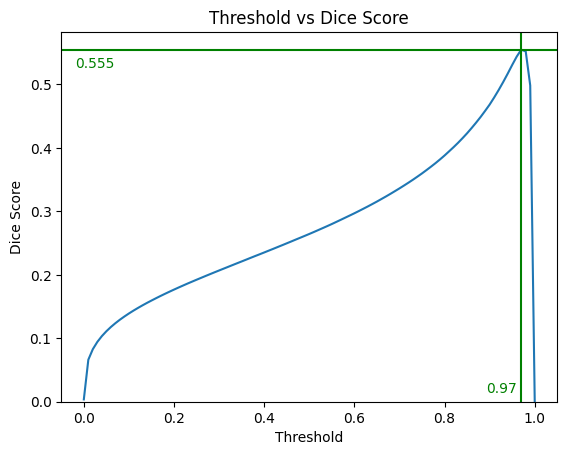

In [31]:
sns.lineplot(data=df_threshold_data, x='Threshold', y='Dice Score')
plt.axhline(y=best_dice_score, color='green')
plt.axvline(x=optim_threshold, color='green')
plt.text(-0.02, best_dice_score * 0.96, f'{best_dice_score:.3f}', va='center', ha='left', color='green')
plt.text(optim_threshold - 0.01, 0.02, f'{optim_threshold}', va='center', ha='right', color='green')
plt.ylim(bottom=0)
plt.title('Threshold vs Dice Score')
plt.show()

# Preview Models Predictions on Validation

Saved plot: plot_output/batch_1_img_1.png


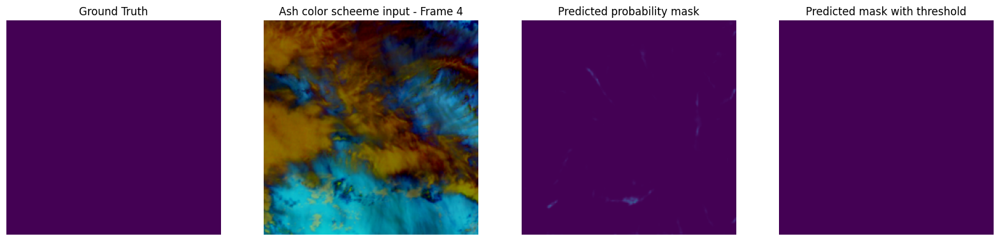

Saved plot: plot_output/batch_1_img_2.png


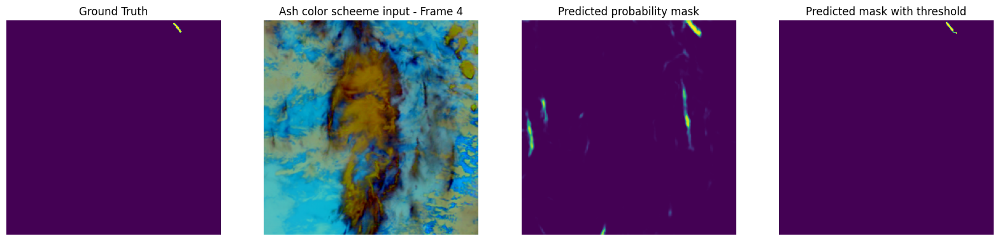

Saved plot: plot_output/batch_1_img_3.png


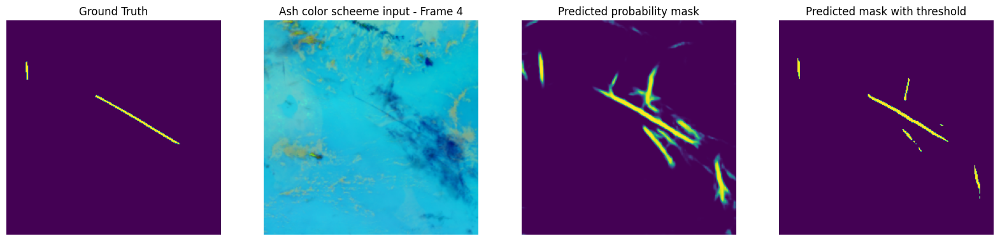

Saved plot: plot_output/batch_1_img_4.png


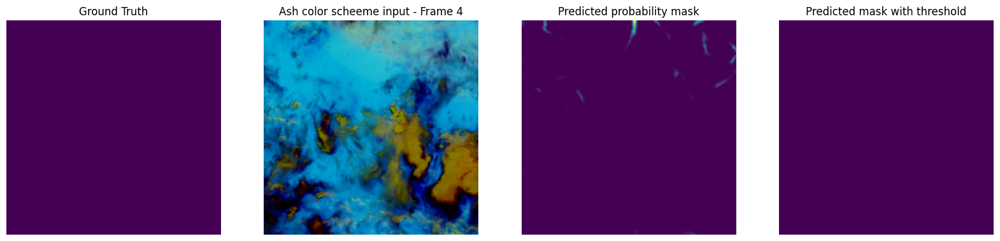

Saved plot: plot_output/batch_1_img_5.png


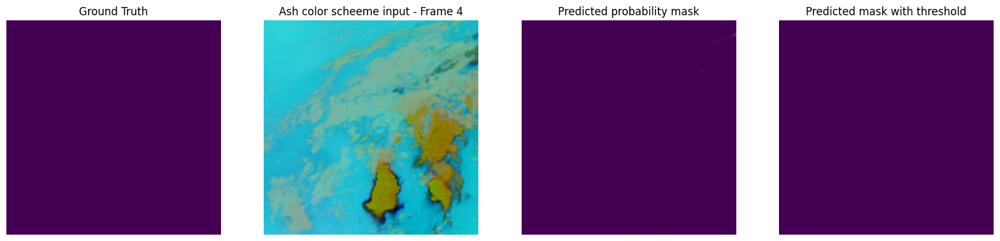

Saved plot: plot_output/batch_1_img_6.png


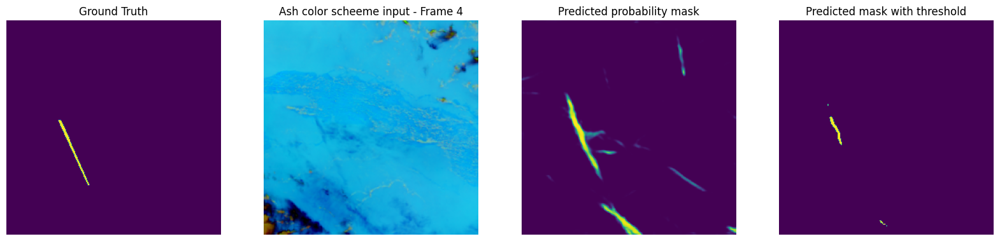

Saved plot: plot_output/batch_1_img_7.png


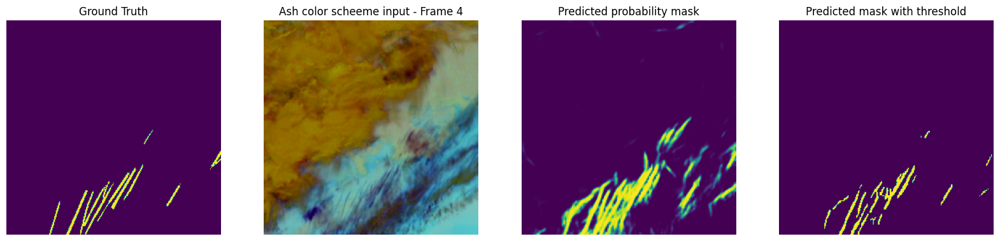

Saved plot: plot_output/batch_1_img_8.png


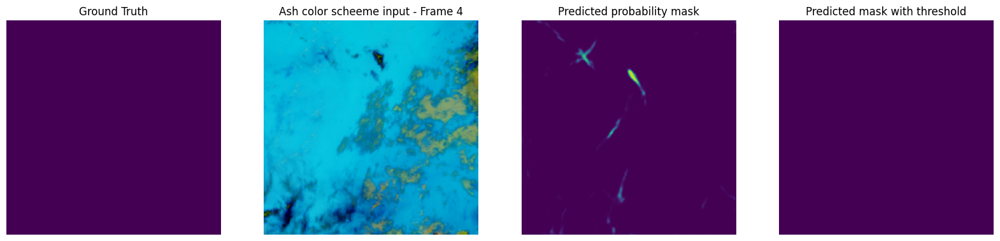

Saved plot: plot_output/batch_1_img_9.png


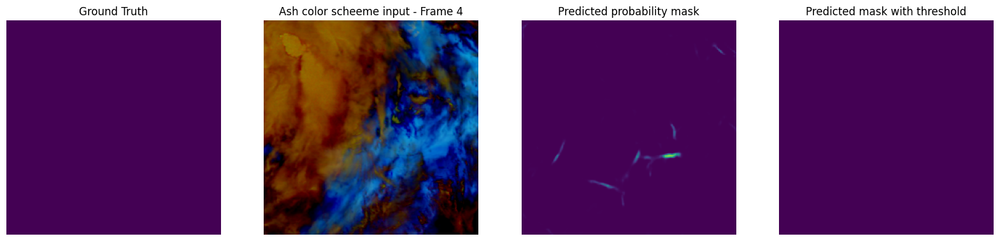

Saved plot: plot_output/batch_1_img_10.png


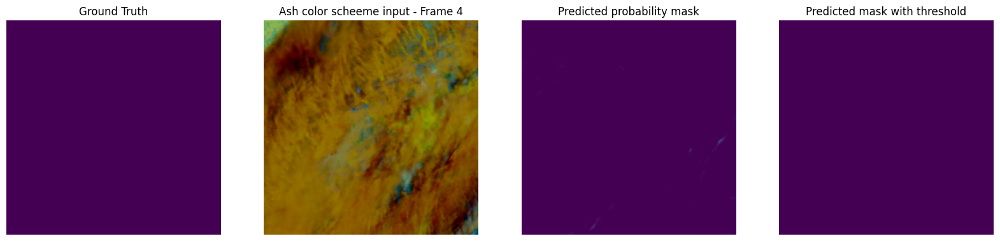

Saved plot: plot_output/batch_1_img_11.png


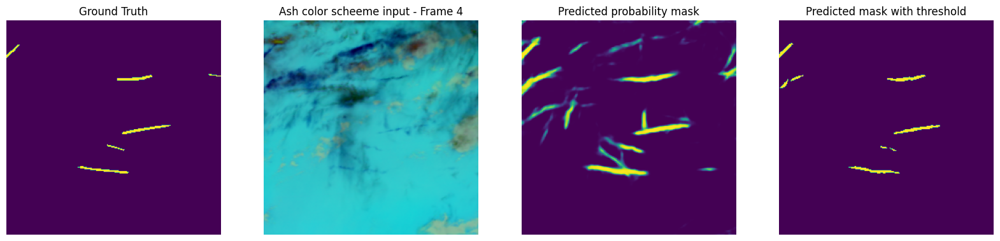

Saved plot: plot_output/batch_1_img_12.png


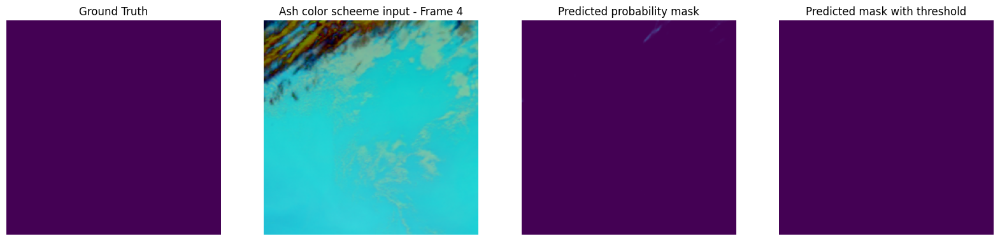

Saved plot: plot_output/batch_1_img_13.png


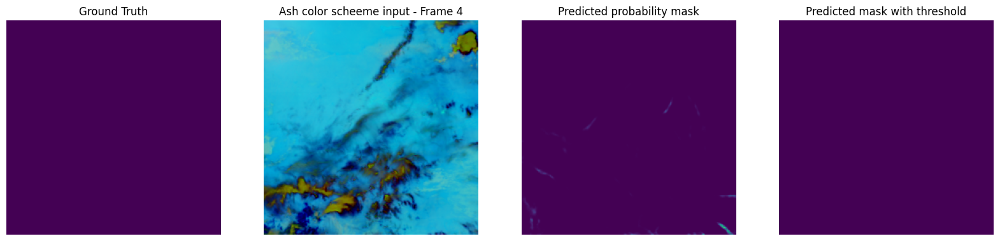

Saved plot: plot_output/batch_1_img_14.png


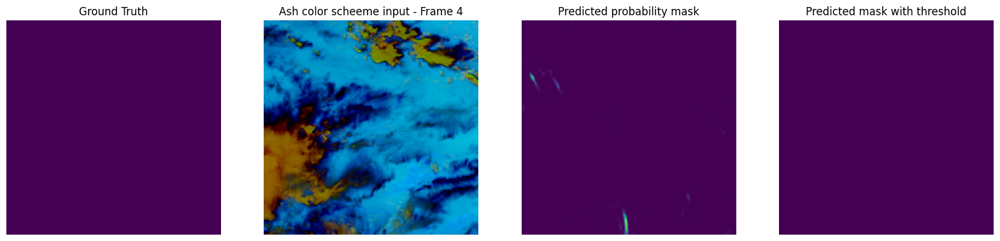

Saved plot: plot_output/batch_1_img_15.png


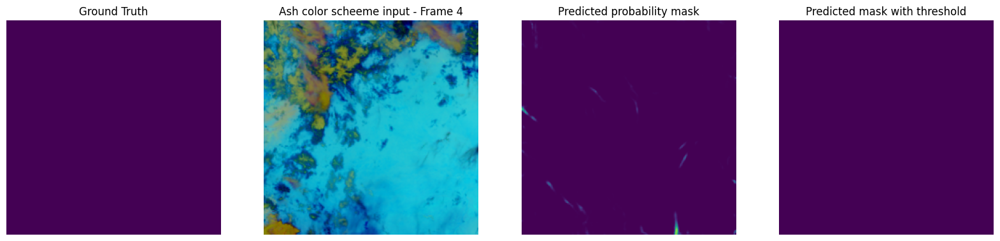

Saved plot: plot_output/batch_1_img_16.png


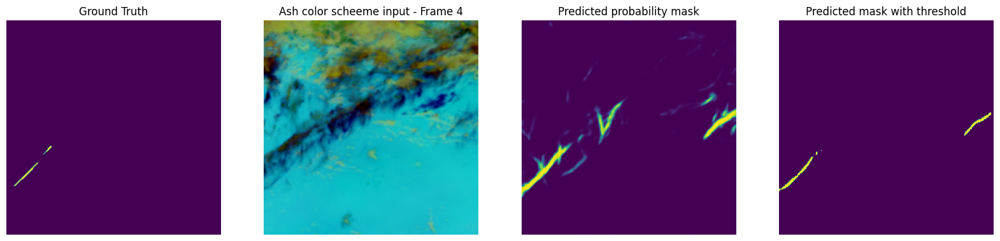

Saved plot: plot_output/batch_2_img_1.png


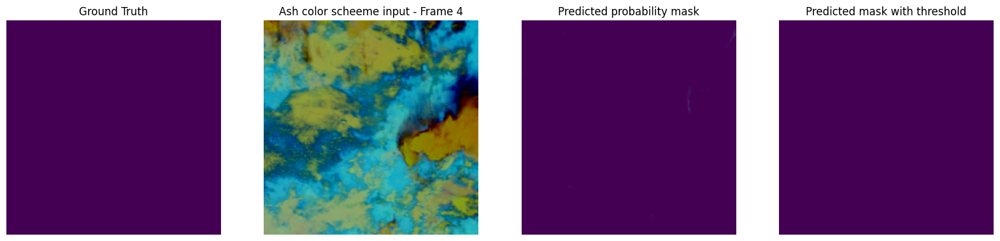

Saved plot: plot_output/batch_2_img_2.png


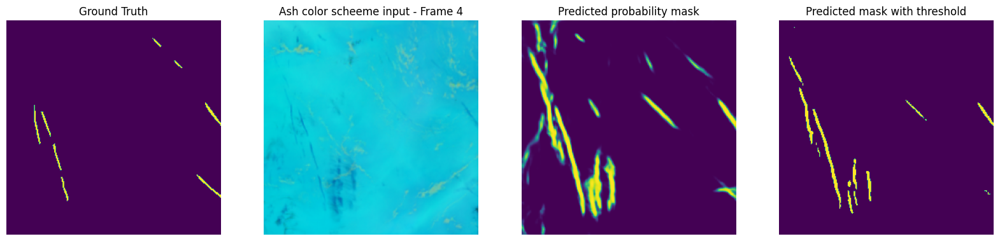

Saved plot: plot_output/batch_2_img_3.png


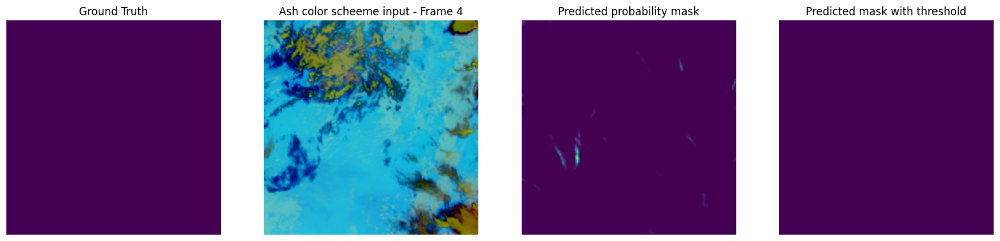

Saved plot: plot_output/batch_2_img_4.png


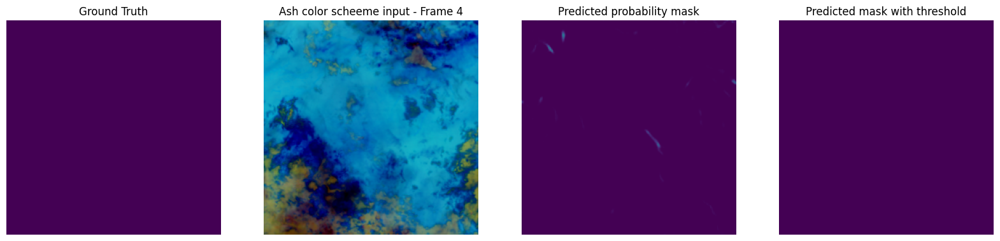

Saved plot: plot_output/batch_2_img_5.png


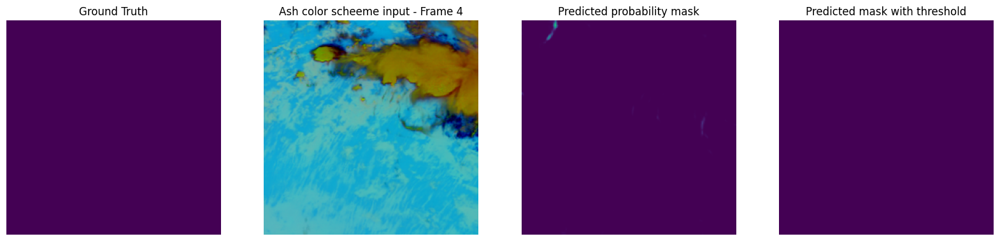

Saved plot: plot_output/batch_2_img_6.png


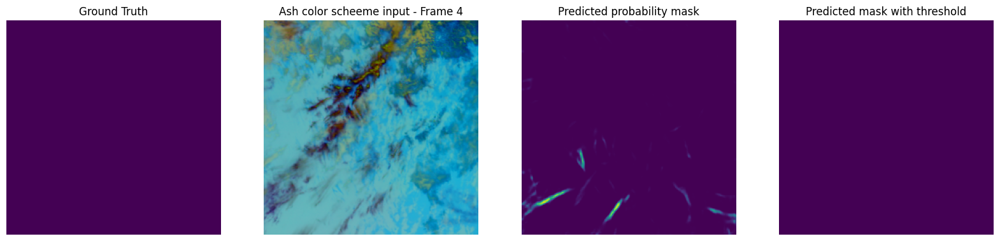

Saved plot: plot_output/batch_2_img_7.png


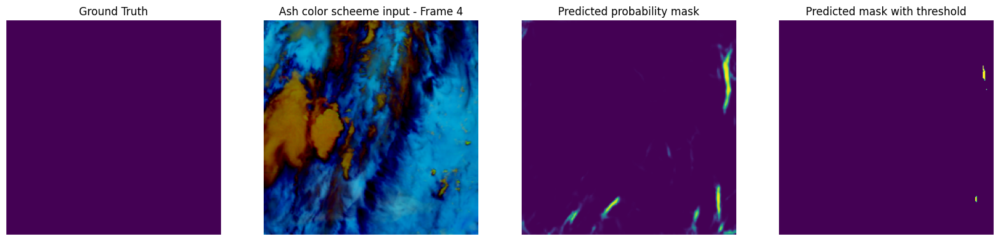

Saved plot: plot_output/batch_2_img_8.png


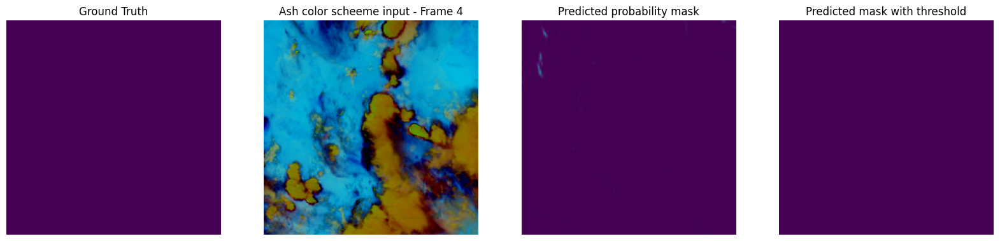

Saved plot: plot_output/batch_2_img_9.png


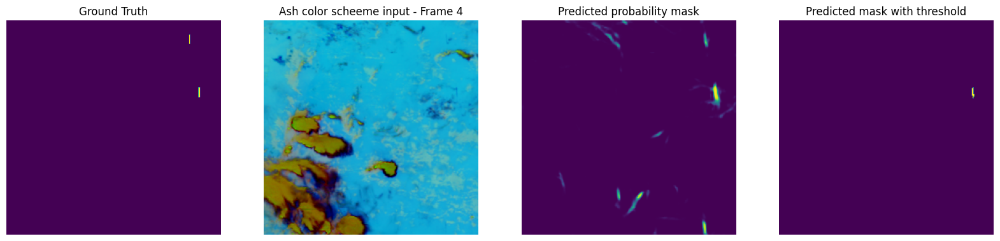

Saved plot: plot_output/batch_2_img_10.png


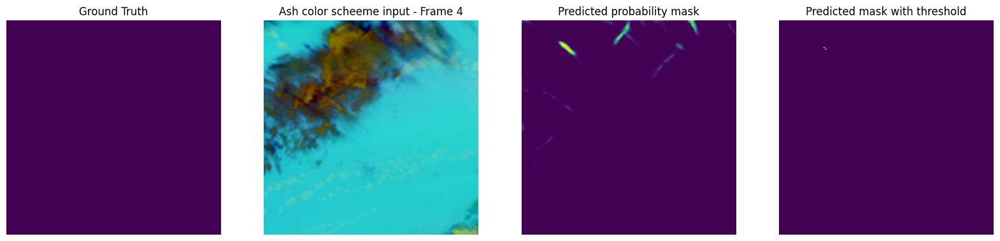

Saved plot: plot_output/batch_2_img_11.png


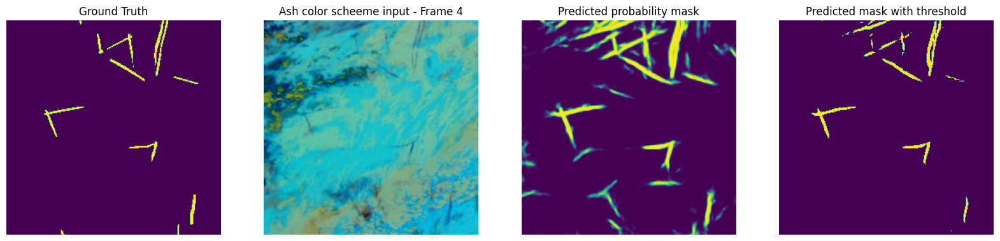

Saved plot: plot_output/batch_2_img_12.png


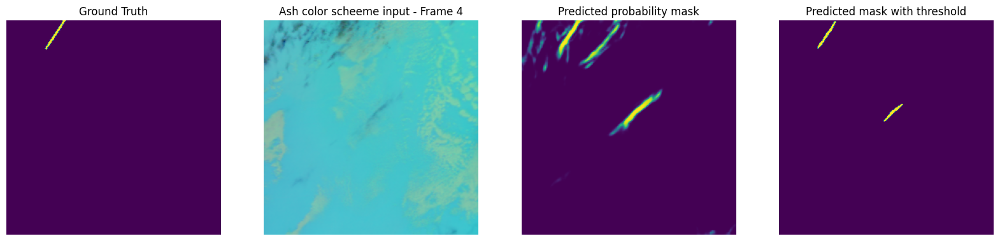

Saved plot: plot_output/batch_2_img_13.png


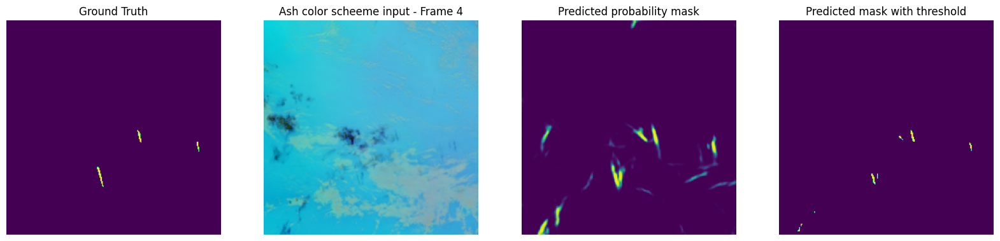

Saved plot: plot_output/batch_2_img_14.png


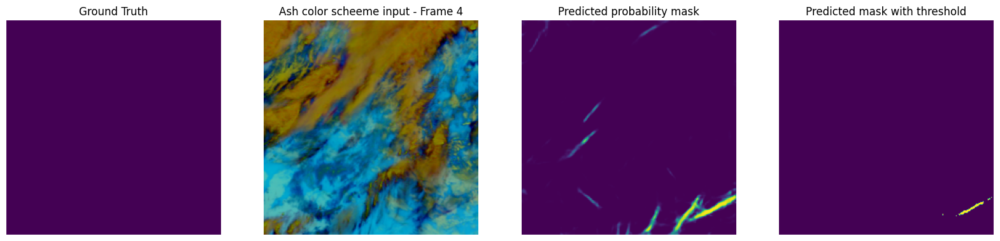

Saved plot: plot_output/batch_2_img_15.png


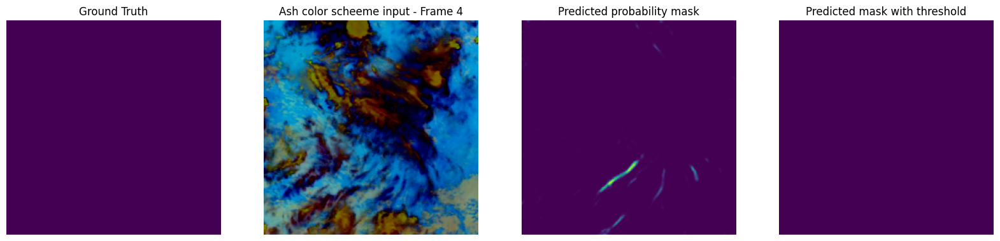

Saved plot: plot_output/batch_2_img_16.png


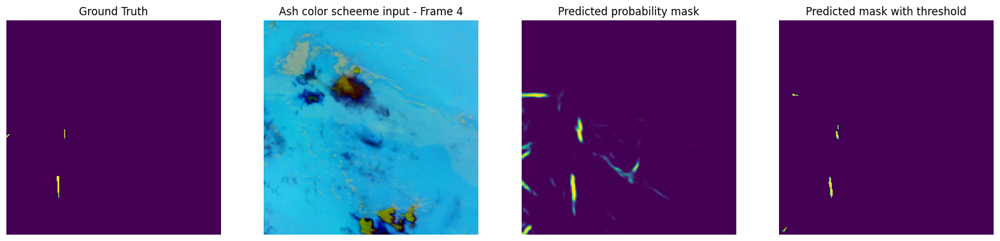

Saved plot: plot_output/batch_3_img_1.png


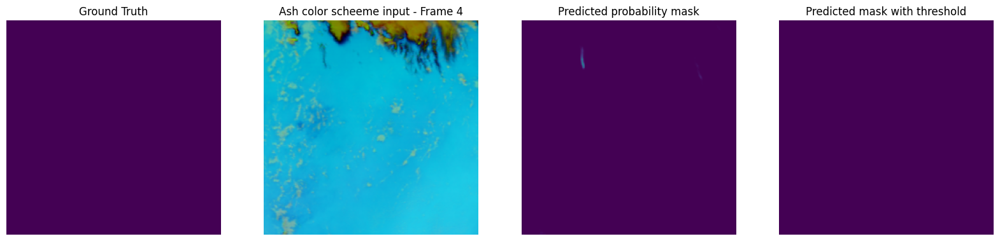

Saved plot: plot_output/batch_3_img_2.png


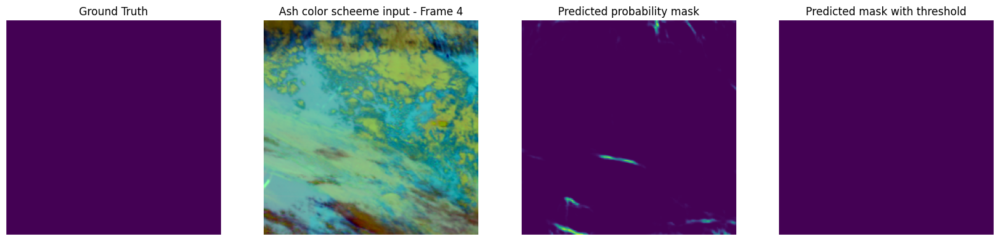

Saved plot: plot_output/batch_3_img_3.png


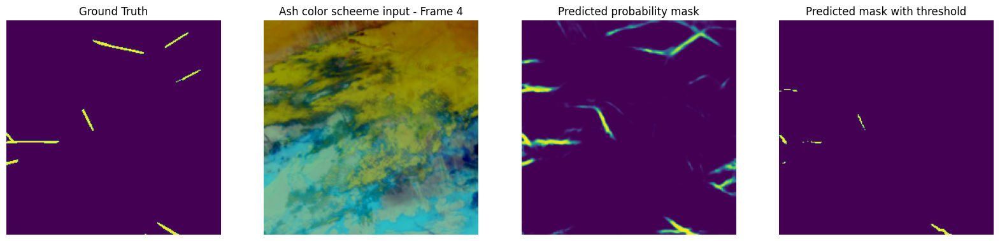

Saved plot: plot_output/batch_3_img_4.png


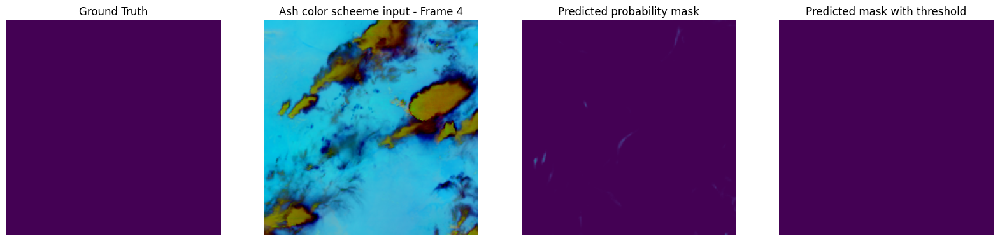

Saved plot: plot_output/batch_3_img_5.png


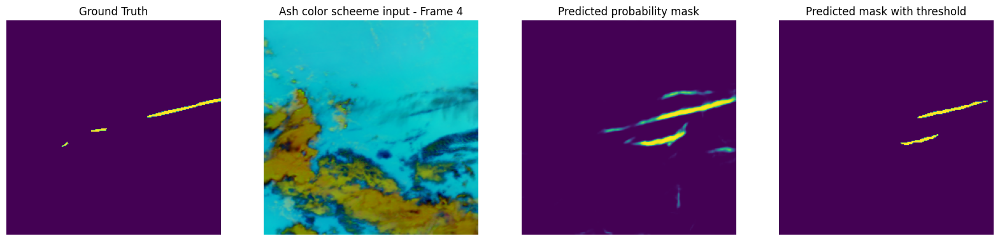

Saved plot: plot_output/batch_3_img_6.png


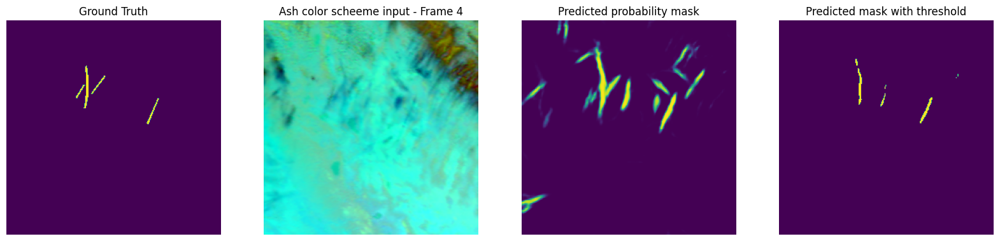

Saved plot: plot_output/batch_3_img_7.png


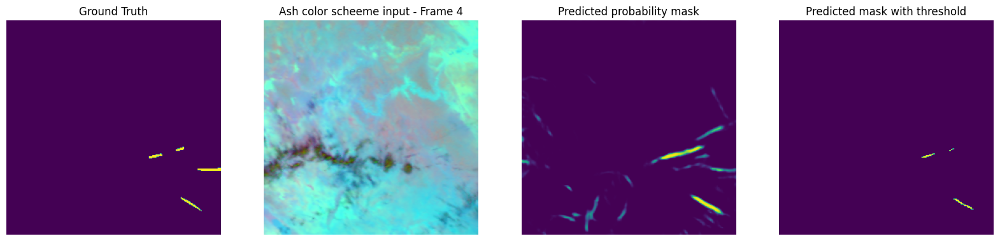

Saved plot: plot_output/batch_3_img_8.png


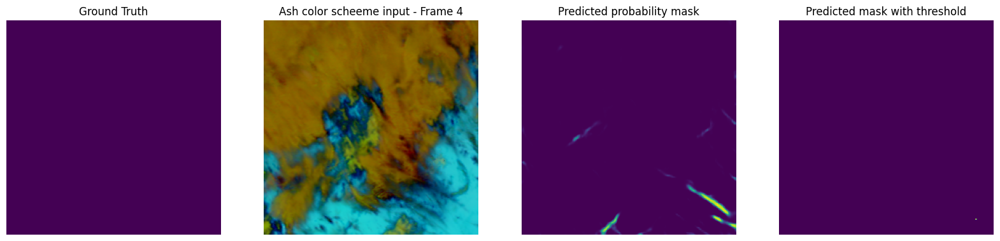

Saved plot: plot_output/batch_3_img_9.png


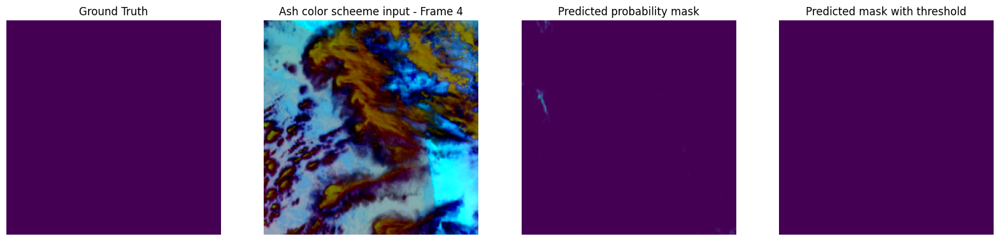

Saved plot: plot_output/batch_3_img_10.png


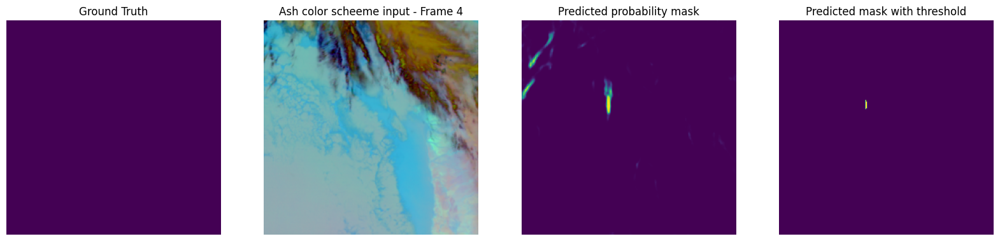

Saved plot: plot_output/batch_3_img_11.png


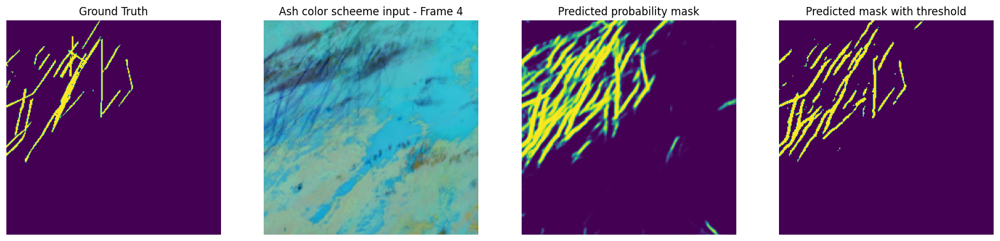

Saved plot: plot_output/batch_3_img_12.png


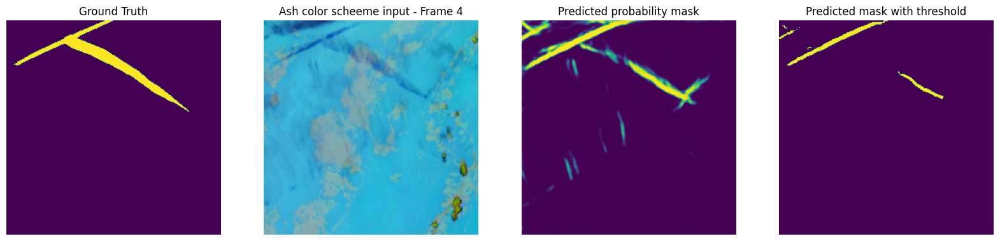

Saved plot: plot_output/batch_3_img_13.png


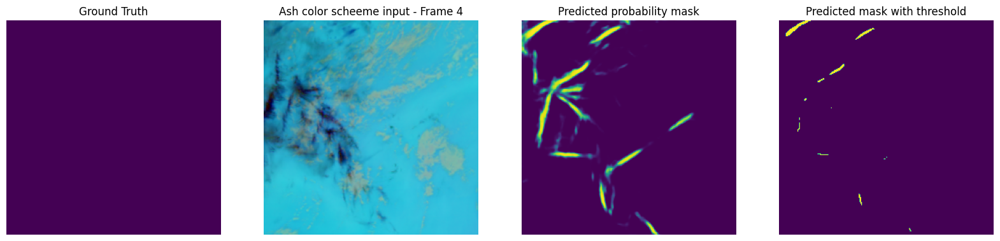

Saved plot: plot_output/batch_3_img_14.png


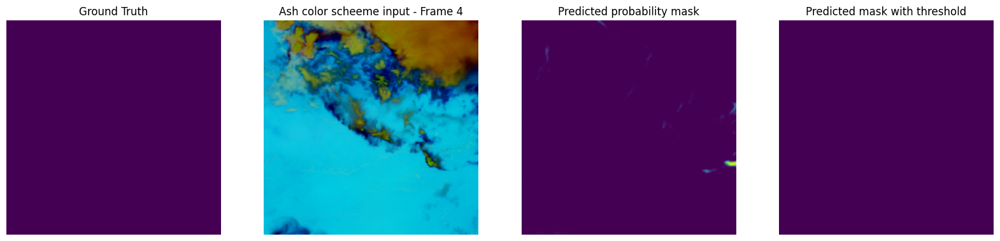

Saved plot: plot_output/batch_3_img_15.png


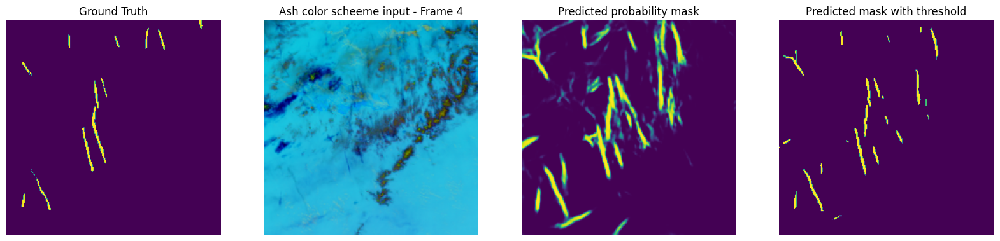

Saved plot: plot_output/batch_3_img_16.png


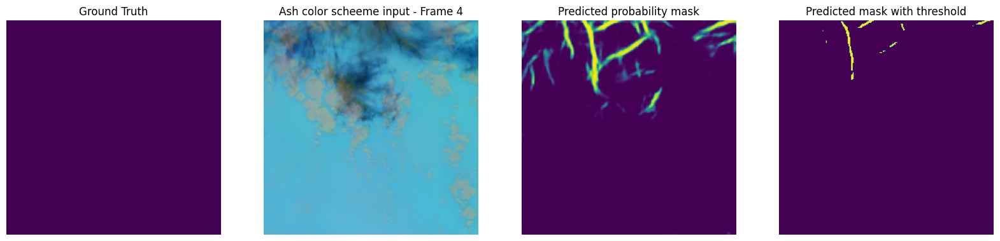

Saved plot: plot_output/batch_4_img_1.png


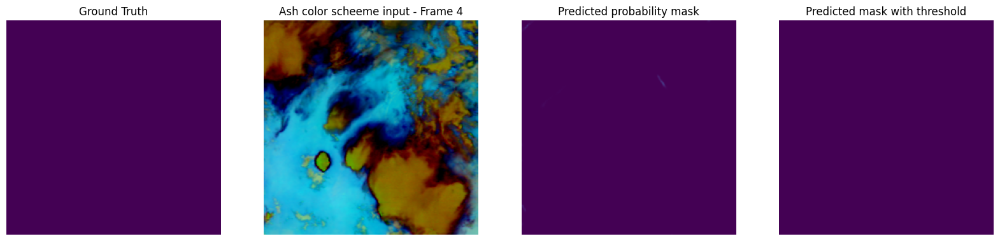

Saved plot: plot_output/batch_4_img_2.png


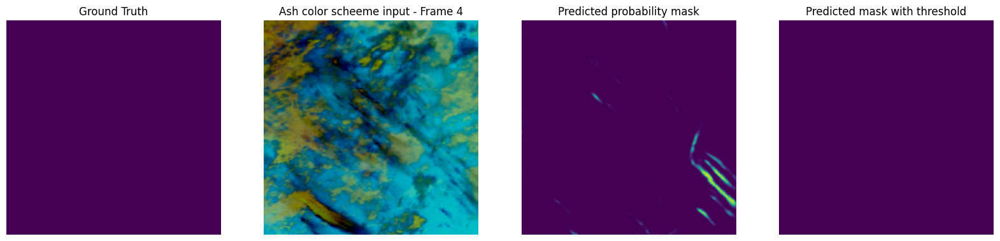

Saved plot: plot_output/batch_4_img_3.png


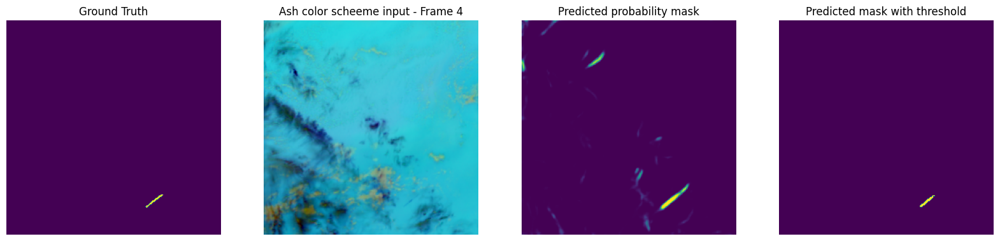

Saved plot: plot_output/batch_4_img_4.png


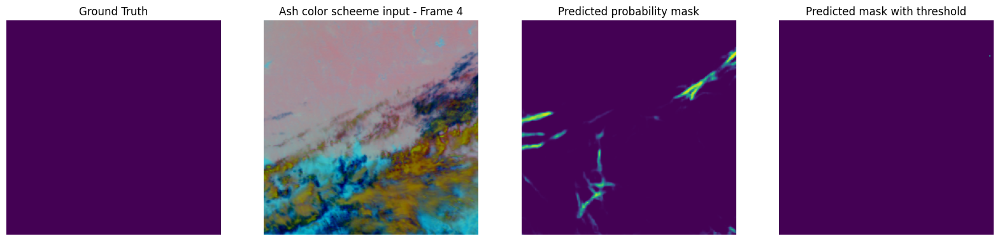

Saved plot: plot_output/batch_4_img_5.png


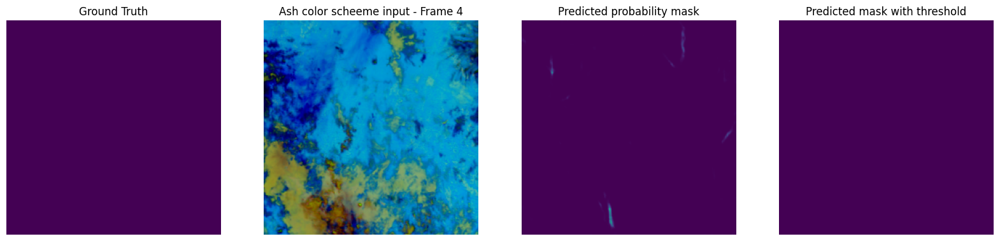

Saved plot: plot_output/batch_4_img_6.png


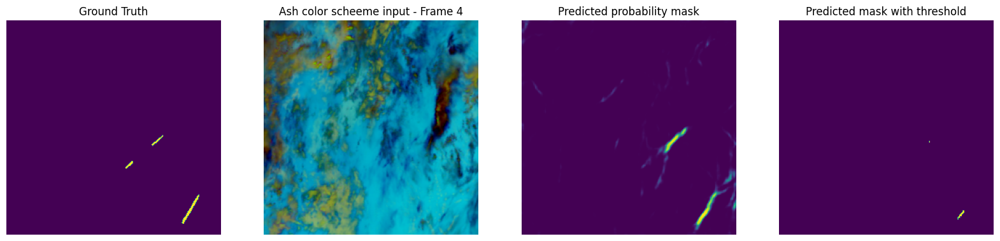

Saved plot: plot_output/batch_4_img_7.png


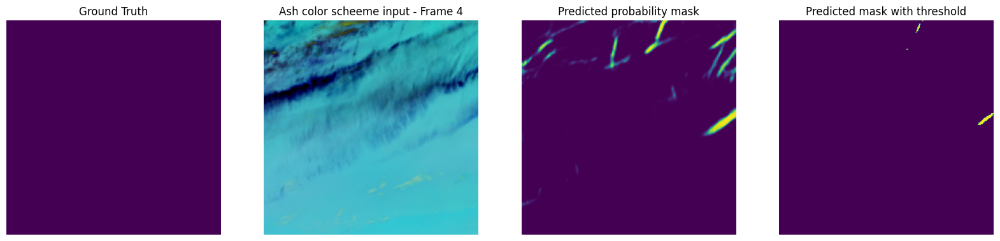

Saved plot: plot_output/batch_4_img_8.png


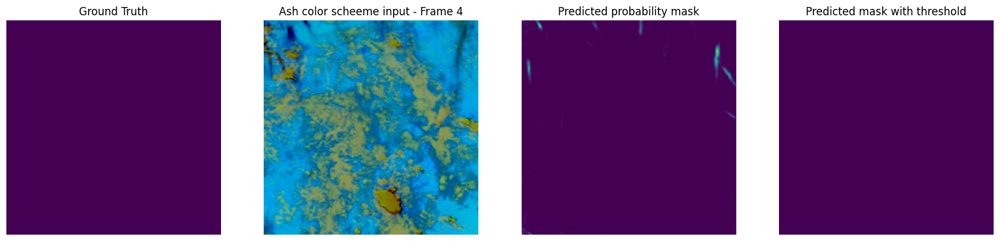

Saved plot: plot_output/batch_4_img_9.png


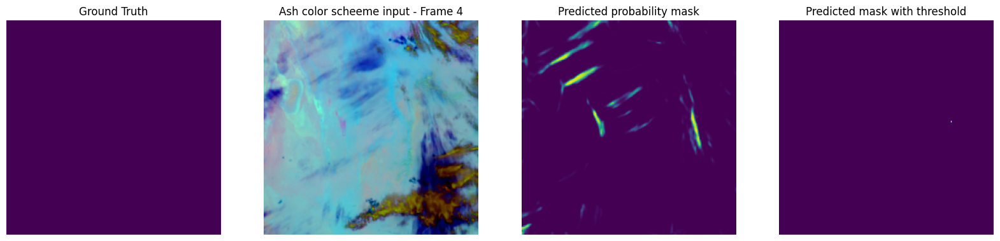

Saved plot: plot_output/batch_4_img_10.png


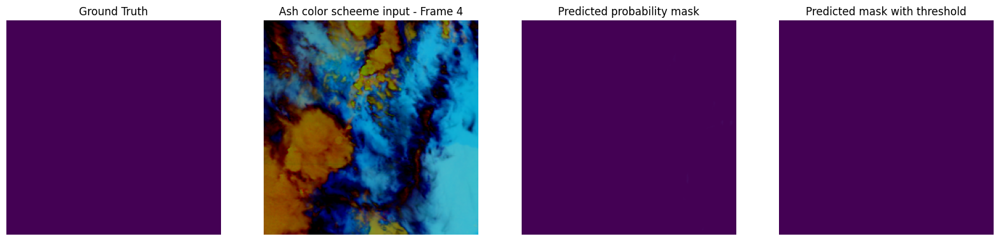

Saved plot: plot_output/batch_4_img_11.png


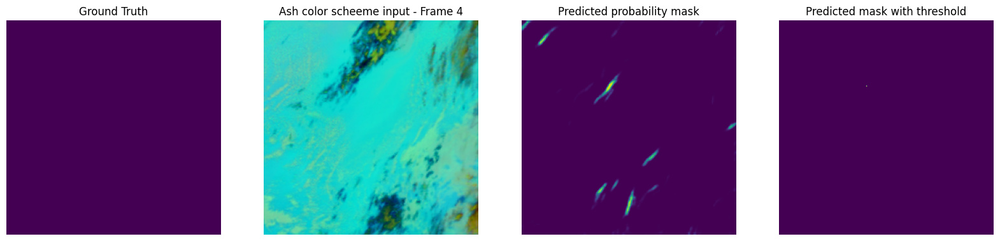

Saved plot: plot_output/batch_4_img_12.png


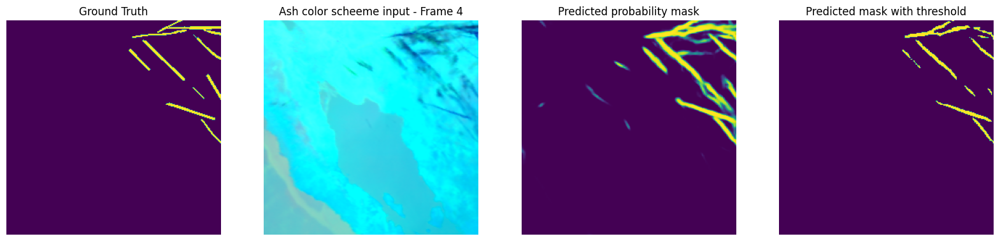

Saved plot: plot_output/batch_4_img_13.png


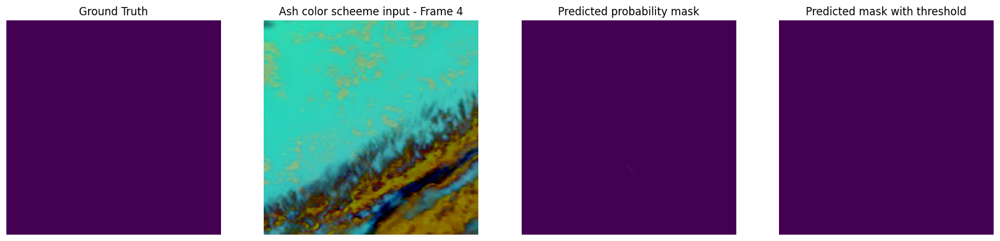

Saved plot: plot_output/batch_4_img_14.png


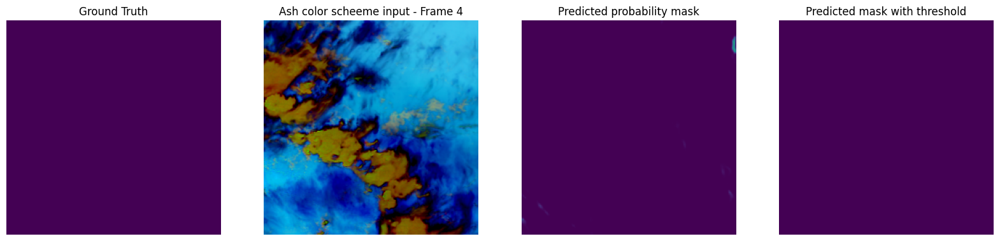

Saved plot: plot_output/batch_4_img_15.png


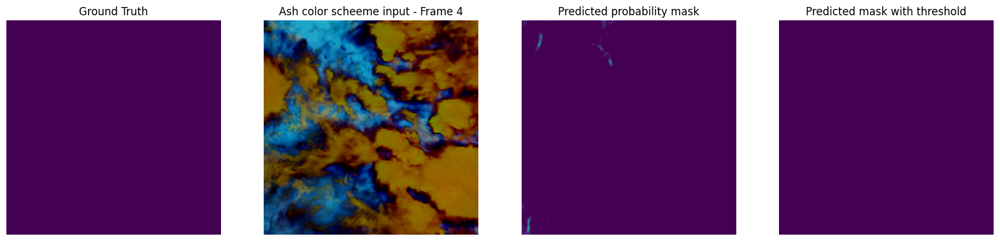

Saved plot: plot_output/batch_4_img_16.png


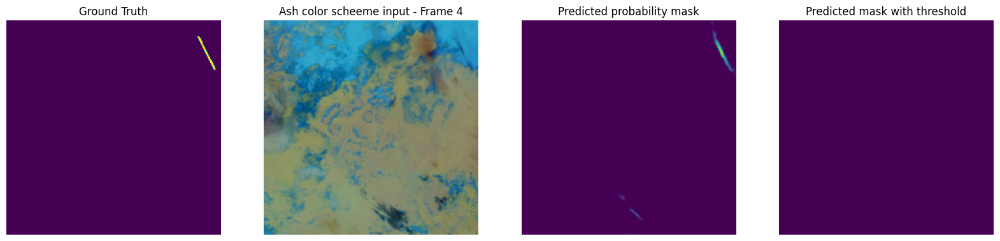

In [32]:
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

batches_to_show = 4
model.eval()

for i, data in enumerate(data_loader_validation):
    images, mask = data
    
    # Predict mask for this instance
    if torch.cuda.is_available():
        images = images.cuda()
    predicated_mask = sigmoid(model.forward(images[:, :, :, :]).cpu().detach().numpy())
    
    # Apply threshold
    predicated_mask_with_threshold = np.zeros((images.shape[0], 256, 256))
    predicated_mask_with_threshold[predicated_mask[:, 0, :, :] < optim_threshold] = 0
    predicated_mask_with_threshold[predicated_mask[:, 0, :, :] > optim_threshold] = 1
    
    images = images.cpu()
        
    for img_num in range(0, images.shape[0]):
        fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(20,10))
        axes = axes.flatten()
        
        # Show groud trought 
        axes[0].imshow(mask[img_num, 0, :, :])
        axes[0].axis('off')
        axes[0].set_title('Ground Truth')
        
        # Show ash color scheme input image
        axes[1].imshow( np.concatenate(
            (
            np.expand_dims(images[img_num, 4, :, :], axis=2),
            np.expand_dims(images[img_num, 12, :, :], axis=2),
            np.expand_dims(images[img_num, 20, :, :], axis=2)
        ), axis=2))
        axes[1].axis('off')
        axes[1].set_title('Ash color scheeme input - Frame 4')

        # Show predicted mask
        axes[2].imshow(predicated_mask[img_num, 0, :, :], vmin=0, vmax=1)
        axes[2].axis('off')
        axes[2].set_title('Predicted probability mask')

        # Show predicted mask after threshold
        axes[3].imshow(predicated_mask_with_threshold[img_num, :, :])
        axes[3].axis('off')
        axes[3].set_title('Predicted mask with threshold')

        output_dir = "plot_output"
        os.makedirs(output_dir, exist_ok=True)

        # Save the plot
        plot_filename = os.path.join(output_dir, f"batch_{i+1}_img_{img_num+1}.png")
        plt.savefig(plot_filename)
        print(f"Saved plot: {plot_filename}")        
        
        plt.show()
    
    if i + 1 >= batches_to_show:
        break